# Scale grayscale image with distance based on depth maps

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
from pathlib import Path
import os

# Get project directory
PROJECT_DIR = Path.cwd().parent.parent.parent
print(f"Project directory: {PROJECT_DIR}")

plt.rcParams["figure.dpi"] = 300

# Data path
DATA_PATH = PROJECT_DIR / "data" / "other" / "images" / "pseudo_NIR"
FIGURE_DIR = PROJECT_DIR / "data" / "other" / "figures" / "methods"

Project directory: /mnt/data/lk1167/projects/AngleCamV2


### Load RGB image

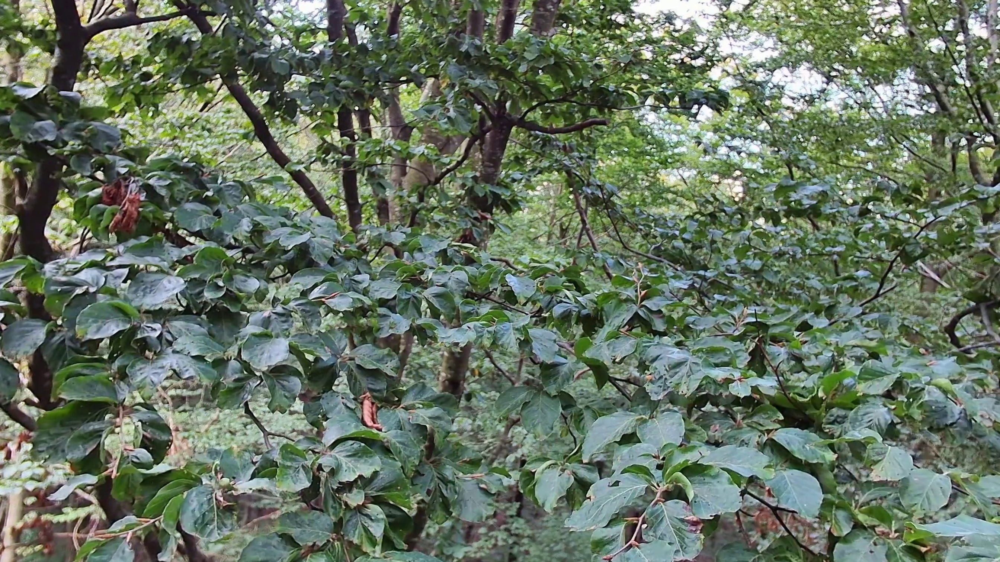

In [ ]:
# Load example RGB image 
RGB_image_path = DATA_PATH / "G5Bullet_31_2024-09-09_15-53-53_calibrated.jpg"
rgb_image = Image.open(RGB_image_path).convert("RGB")

rgb_image

### Convert to grayscale

In [3]:
# Convert to numpy array (0-1 range)
image_array = np.array(rgb_image).astype(np.float32) / 255.0

# Convert to grayscale
gray_image = np.dot(image_array[..., :3], [0.299, 0.587, 0.114])

# Scale back to 0-255 range
gray_image = (gray_image * 255).astype(np.uint8)

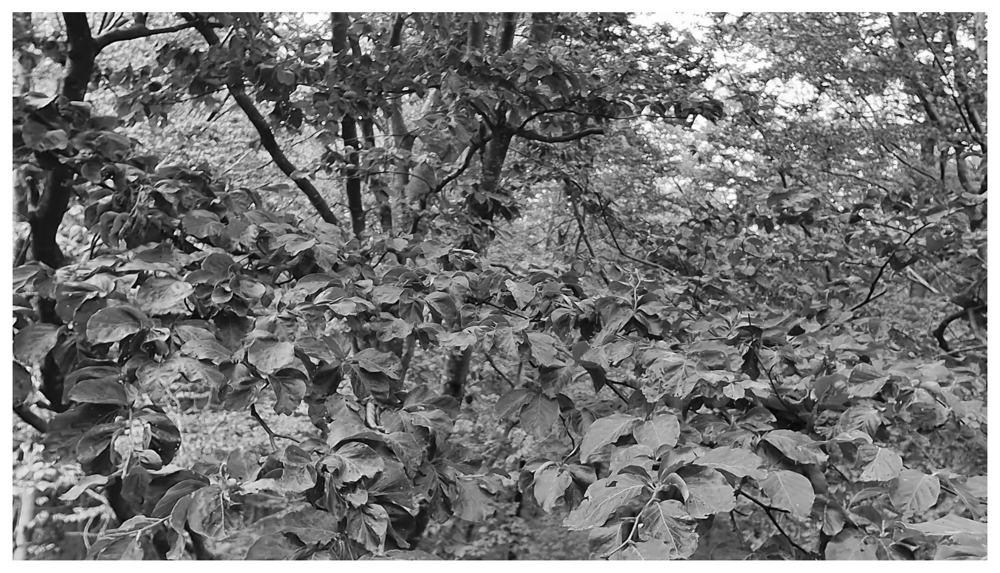

True

In [4]:
# Save grayscale image
plt.figure(figsize=(10, 10))
plt.imshow(gray_image, cmap='gray')
plt.axis("off")
plt.show()

# Save as PNG
cv2.imwrite(str(FIGURE_DIR / 'gray_image.png'), gray_image)

### Load corresponding depth map (precalculated)

See https://github.com/Luis-Kr/DepthMap for implementation

In [5]:
# Load the corresponding PseudoIR image
depth_map_path = DATA_PATH / "G5Bullet_31_2024-09-09_15-53-53_calibrated_depth.npy"
depth_map = np.load(depth_map_path)

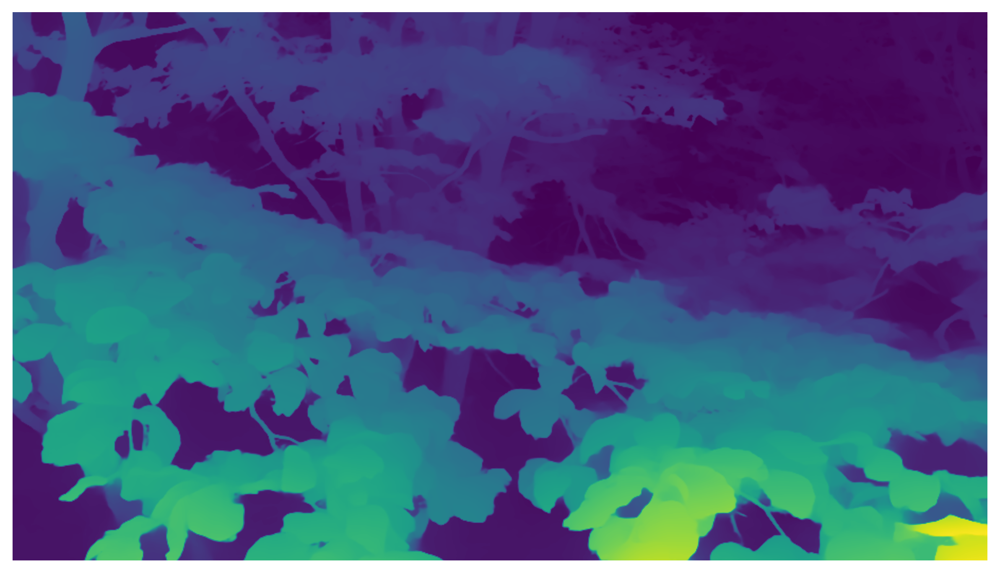

In [6]:
# Visualize the depth map
plt.figure(figsize=(10, 10))
plt.imshow(depth_map)
plt.axis("off")
plt.show()
plt.imsave(FIGURE_DIR / 'depth_map_viridis.png', depth_map, cmap='viridis')

### Distance based dimming of the grayscale image with depth map

In [8]:
# Apply distance-based scaling: I_IR = I_gray * (d0/d)^2 ( (d0/d)^2 already done)
#distance_factor = (1 / depth_map + 0.01) ** 2
distance_factor = depth_map

# Apply scaling to all channels
dimmed_image = gray_image.copy().astype(np.float32)
dimmed_image *= distance_factor

# Modify normalization range and clip values to 0-1 range
min_val = np.percentile(dimmed_image, 10) 
max_val = np.percentile(dimmed_image, 90)  
dimmed_image = np.clip((dimmed_image - min_val) / (max_val - min_val), 0, 1)

# Expand dims to 3 channels
dimmed_image = np.expand_dims(dimmed_image, axis=2)
dimmed_image = np.repeat(dimmed_image, 3, axis=2)

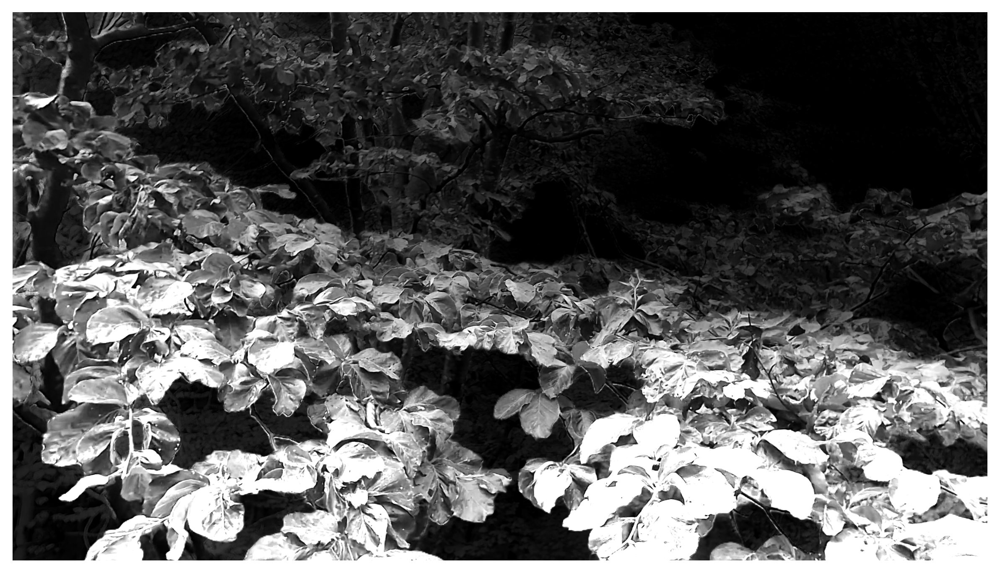

In [9]:
# Visualize the depth map
plt.figure(figsize=(10, 10))
plt.imshow(dimmed_image, cmap='gray')
plt.axis("off")
plt.show()

In [78]:
# Save image as PNG
# Convert to uint8 
if dimmed_image.dtype != np.uint8:
    dimmed_image_uint8 = (dimmed_image * 255).astype(np.uint8)
else:
    dimmed_image_uint8 = dimmed_image

# Save as PNG
cv2.imwrite(FIGURE_DIR / 'pseudo_ir.png', dimmed_image_uint8)

True

### Sample 02

In [10]:
# Load example RGB image 
RGB_image_path_02 = DATA_PATH / "G5Bullet_40_2024-09-08_15-24-19_calibrated.jpg" #"ID_0107_RGB.png"
rgb_image_02 = Image.open(RGB_image_path_02).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_02 = np.array(rgb_image_02).astype(np.float32) / 255.0

# Convert to grayscale
gray_image_02 = np.dot(image_array_02[..., :3], [0.299, 0.587, 0.114])

# Scale back to 0-255 range
gray_image_02 = (gray_image_02 * 255).astype(np.uint8)

# Load the corresponding PseudoIR image
depth_map_path_02 = DATA_PATH / "G5Bullet_40_2024-09-08_15-24-19_calibrated_depth.npy" #"ID_0107_RGB_dpm.npy"
depth_map_02 = np.load(depth_map_path_02)

# Apply distance-based scaling: I_IR = I_gray * (d0/d)^2 -> (d0/d)^2 already done
distance_factor_02 = depth_map_02

# Apply scaling to all channels
dimmed_image_02 = gray_image_02.copy().astype(np.float32)
dimmed_image_02 *= distance_factor_02

# Modify normalization range and clip values to 0-1 range
min_val = np.percentile(dimmed_image_02, 10)  
max_val = np.percentile(dimmed_image_02, 90)  
dimmed_image_02 = np.clip((dimmed_image_02 - min_val) / (max_val - min_val), 0, 1)

# Expand dims to 3 channels
dimmed_image_02 = np.expand_dims(dimmed_image_02, axis=2)
dimmed_image_02 = np.repeat(dimmed_image_02, 3, axis=2)

In [11]:
# Load real NIR image
nir_image_path = DATA_PATH / "G5Bullet_31_2024-09-09_00-22-14_calibrated.jpg"
nir_image = Image.open(nir_image_path).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_nir = np.array(nir_image).astype(np.float32) / 255.0

nir_image_path_02 = DATA_PATH / "G5Bullet_40_2024-09-08_00-43-23_calibrated.jpg"
nir_image_02 = Image.open(nir_image_path_02).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_nir_02 = np.array(nir_image_02).astype(np.float32) / 255.0

### Sample 03

In [ ]:
# Load example RGB image 
RGB_image_path_03 = DATA_PATH / "G5Bullet_32_2024-09-09_11-02-37_calibrated.jpg" 
rgb_image_03 = Image.open(RGB_image_path_03).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_03 = np.array(rgb_image_03).astype(np.float32) / 255.0

# Convert to grayscale
gray_image_03 = np.dot(image_array_03[..., :3], [0.299, 0.587, 0.114])

# Scale back to 0-255 range
gray_image_03 = (gray_image_03 * 255).astype(np.uint8)

# Load the corresponding PseudoIR image
depth_map_path_03 = DATA_PATH / "G5Bullet_32_2024-09-09_11-02-37_calibrated_depth.npy" 
depth_map_03 = np.load(depth_map_path_03)

# Apply distance-based scaling: I_IR = I_gray * (d0/d)^2 -> (d0/d)^2 already done
distance_factor_03 = depth_map_03

# Apply scaling to all channels
dimmed_image_03 = gray_image_03.copy().astype(np.float32)
dimmed_image_03 *= distance_factor_03

# Modify normalization range and clip values to 0-1 range
min_val = np.percentile(dimmed_image_03, 10)  
max_val = np.percentile(dimmed_image_03, 90)  
dimmed_image_03 = np.clip((dimmed_image_03 - min_val) / (max_val - min_val), 0, 1)

# Expand dims to 3 channels
dimmed_image_03 = np.expand_dims(dimmed_image_03, axis=2)
dimmed_image_03 = np.repeat(dimmed_image_03, 3, axis=2)

nir_image_path_03 = DATA_PATH / "G5Bullet_32_2024-09-09_00-09-16_calibrated.jpg"
nir_image_03 = Image.open(nir_image_path_03).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_nir_03 = np.array(nir_image_03).astype(np.float32) / 255.0

In [18]:
# Load example RGB image 
file_name_rgb = "G5Bullet_26_2024-09-07_10-25-40_calibrated"
file_name_nir = "G5Bullet_26_2024-09-07_00-08-54_calibrated"

RGB_image_path_03 = DATA_PATH / f"{file_name_rgb}.jpg" 
rgb_image_03 = Image.open(RGB_image_path_03).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_03 = np.array(rgb_image_03).astype(np.float32) / 255.0

# Convert to grayscale
gray_image_03 = np.dot(image_array_03[..., :3], [0.299, 0.587, 0.114])

# Scale back to 0-255 range
gray_image_03 = (gray_image_03 * 255).astype(np.uint8)

# Load the corresponding PseudoIR image
depth_map_path_03 = DATA_PATH / f"{file_name_rgb}_depth.npy" 
depth_map_03 = np.load(depth_map_path_03)

# Apply distance-based scaling: I_IR = I_gray * (d0/d)^2 -> (d0/d)^2 already done
distance_factor_03 = depth_map_03

# Apply scaling to all channels
dimmed_image_03 = gray_image_03.copy().astype(np.float32)
dimmed_image_03 *= distance_factor_03

# Modify normalization range and clip values to 0-1 range
min_val = np.percentile(dimmed_image_03, 10)  
max_val = np.percentile(dimmed_image_03, 90)  
dimmed_image_03 = np.clip((dimmed_image_03 - min_val) / (max_val - min_val), 0, 1)

# Expand dims to 3 channels
dimmed_image_03 = np.expand_dims(dimmed_image_03, axis=2)
dimmed_image_03 = np.repeat(dimmed_image_03, 3, axis=2)

nir_image_path_03 = DATA_PATH / f"{file_name_nir}.jpg"
nir_image_03 = Image.open(nir_image_path_03).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_nir_03 = np.array(nir_image_03).astype(np.float32) / 255.0

In [20]:
# Load example RGB image 
file_name_rgb = "G5Bullet_43_2024-09-09_18-09-42_calibrated"
file_name_nir = "G5Bullet_43_2024-09-08_00-09-57_calibrated"

RGB_image_path_03 = DATA_PATH / f"{file_name_rgb}.jpg" 
rgb_image_03 = Image.open(RGB_image_path_03).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_03 = np.array(rgb_image_03).astype(np.float32) / 255.0

# Convert to grayscale
gray_image_03 = np.dot(image_array_03[..., :3], [0.299, 0.587, 0.114])

# Scale back to 0-255 range
gray_image_03 = (gray_image_03 * 255).astype(np.uint8)

# Load the corresponding PseudoIR image
depth_map_path_03 = DATA_PATH / f"{file_name_rgb}_depth.npy" 
depth_map_03 = np.load(depth_map_path_03)

# Apply distance-based scaling: I_IR = I_gray * (d0/d)^2 -> (d0/d)^2 already done
distance_factor_03 = depth_map_03

# Apply scaling to all channels
dimmed_image_03 = gray_image_03.copy().astype(np.float32)
dimmed_image_03 *= distance_factor_03

# Modify normalization range and clip values to 0-1 range
min_val = np.percentile(dimmed_image_03, 10)  
max_val = np.percentile(dimmed_image_03, 90)  
dimmed_image_03 = np.clip((dimmed_image_03 - min_val) / (max_val - min_val), 0, 1)

# Expand dims to 3 channels
dimmed_image_03 = np.expand_dims(dimmed_image_03, axis=2)
dimmed_image_03 = np.repeat(dimmed_image_03, 3, axis=2)

nir_image_path_03 = DATA_PATH / f"{file_name_nir}.jpg"
nir_image_03 = Image.open(nir_image_path_03).convert("RGB")

# Convert to numpy array (0-1 range)
image_array_nir_03 = np.array(nir_image_03).astype(np.float32) / 255.0

### Sample plot

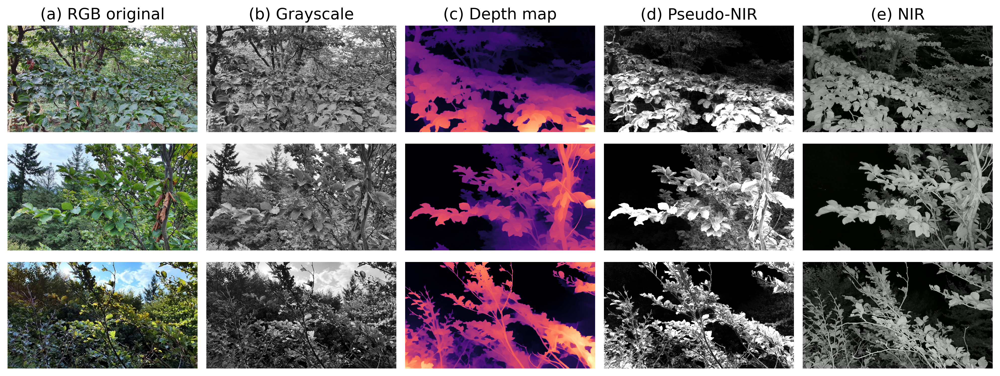

In [24]:
# Create the plot: 3 rows x 4 columns
fig, axes = plt.subplots(3, 5, figsize=(18, 5))

column_titles = ["RGB original", "Grayscale", "Depth map", "Pseudo-NIR", "NIR"]

# RGB image
axes[0,0].imshow(rgb_image)
axes[0,0].set_title(f"(a) {column_titles[0]}", fontsize=15)
axes[0,0].axis("off")

# Grayscale image
axes[0,1].imshow(gray_image, cmap="gray")
axes[0,1].set_title(f"(b) {column_titles[1]}", fontsize=15)
axes[0,1].axis("off")

# Depth map
axes[0,2].imshow(depth_map, cmap="magma")
axes[0,2].set_title(f"(c) {column_titles[2]}", fontsize=15)
axes[0,2].axis("off")

# Depth-scaled grayscale
axes[0,3].imshow(dimmed_image, cmap="gray")
axes[0,3].set_title(f"(d) {column_titles[3]}", fontsize=15)
axes[0,3].axis("off")

# NIR
axes[0,4].imshow(image_array_nir, cmap="gray")
axes[0,4].set_title(f"(e) {column_titles[4]}", fontsize=15)
axes[0,4].axis("off")

## Sample 02
# RGB image
axes[1,0].imshow(rgb_image_02)
axes[1,0].axis("off")

# Grayscale image
axes[1,1].imshow(gray_image_02, cmap="gray")
axes[1,1].axis("off")

# Depth map
axes[1,2].imshow(depth_map_02, cmap="magma")
axes[1,2].axis("off")

# Depth-scaled grayscale
axes[1,3].imshow(dimmed_image_02, cmap="gray")
axes[1,3].axis("off")

# NIR
axes[1,4].imshow(image_array_nir_02, cmap="gray")
axes[1,4].axis("off")

## Sample 03
# RGB image
axes[2,0].imshow(rgb_image_03)
axes[2,0].axis("off")

# Grayscale image
axes[2,1].imshow(gray_image_03, cmap="gray")
axes[2,1].axis("off")

# Depth map
axes[2,2].imshow(depth_map_03, cmap="magma")
axes[2,2].axis("off")

# Depth-scaled grayscale
axes[2,3].imshow(dimmed_image_03, cmap="gray")
axes[2,3].axis("off")

# NIR
axes[2,4].imshow(image_array_nir_03, cmap="gray")
axes[2,4].axis("off")

plt.tight_layout()
plt.subplots_adjust(left=0.25, top=0.94)
plt.savefig(FIGURE_DIR / "RGB_Grayscale_Depth_PseudoIR.png", dpi=400, bbox_inches="tight")
plt.show()

### Further examples

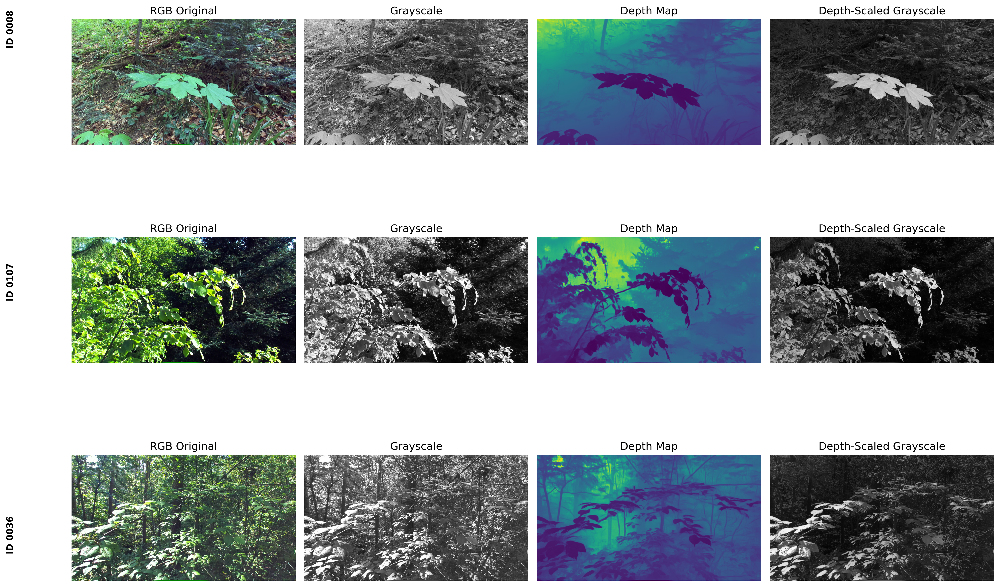

In [30]:
# Select specific images
selected_image_names = ["ID_0008_RGB.png", "ID_0107_RGB.png", "ID_0036_RGB.png"]
sample_files = [str(DATA_PATH / name) for name in selected_image_names]

def process_image_sample(rgb_path: str) -> tuple:
    """Process a single image sample through the complete pipeline."""
    # Load RGB image
    rgb_image = cv2.imread(rgb_path)
    rgb_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2RGB)
    
    # Convert to grayscale
    grayscale_image = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2GRAY)
    
    # Load corresponding depth map
    base_name = os.path.basename(rgb_path).replace('.png', '')
    depth_path = os.path.join(os.path.dirname(rgb_path), f"{base_name}_dpm.npy")
    
    if not os.path.exists(depth_path):
        print(f"Warning: Depth map not found for {base_name}")
        return None
    
    depth_map = np.load(depth_path)
    
    # Apply depth-based scaling to grayscale
    distance_factor = (1 / (depth_map + 1.5)) ** 2
    distance_factor = distance_factor / np.max(distance_factor)  # Normalize factor
    
    scaled_grayscale = grayscale_image.astype(np.float32) * distance_factor
    
    return rgb_image, grayscale_image, depth_map, scaled_grayscale

# Process all samples
processed_samples = []
valid_samples = []

for rgb_path in sample_files:
    result = process_image_sample(rgb_path)
    if result is not None:
        processed_samples.append(result)
        valid_samples.append(os.path.basename(rgb_path))

if len(processed_samples) == 0:
    print("Error: No valid image samples could be processed")
else:
    # Create the plot: 3 rows x 4 columns
    fig, axes = plt.subplots(len(processed_samples), 4, figsize=(16, 4 * len(processed_samples)))
    
    # Ensure axes is 2D even for single row
    if len(processed_samples) == 1:
        axes = axes.reshape(1, -1)
    
    column_titles = ['RGB Original', 'Grayscale', 'Depth Map', 'Depth-Scaled Grayscale']
    
    for i, (rgb_img, gray_img, depth_img, scaled_img) in enumerate(processed_samples):
        sample_name = valid_samples[i].replace('_RGB.png', '').replace('_', ' ')
        
        # RGB image
        axes[i, 0].imshow(rgb_img)
        axes[i, 0].set_title(f'{column_titles[0]}')
        axes[i, 0].axis('off')
        
        # Grayscale image
        axes[i, 1].imshow(gray_img, cmap='gray')
        axes[i, 1].set_title(f'{column_titles[1]}')
        axes[i, 1].axis('off')
        
        # Depth map
        axes[i, 2].imshow(depth_img, cmap='viridis')
        axes[i, 2].set_title(f'{column_titles[2]}')
        axes[i, 2].axis('off')
        
        # Depth-scaled grayscale
        axes[i, 3].imshow(scaled_img, cmap='gray')
        axes[i, 3].set_title(f'{column_titles[3]}')
        axes[i, 3].axis('off')
        
        # Add sample name on the left side
        if i < len(processed_samples):
            fig.text(0.02, 1 - (i + 0.5) / len(processed_samples), sample_name, 
                    rotation=90, va='center', ha='center', fontsize=10, fontweight='bold')
    
    plt.tight_layout()
    plt.subplots_adjust(left=0.08, top=0.94)
    
    # Save the figure
    #plt.savefig(FIGURE_DIR / 'multiple_samples.png', dpi=300, bbox_inches='tight')
    plt.show()